https://towardsdatascience.com/data-visualization-with-bokeh-in-python-part-ii-interactions-a4cf994e2512

In [57]:
from pathlib import Path

import scipy
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [58]:
filepath = "/Users/kperks/mnt/PerksLab_rstore/neurophysiology_lab/CockroachLeg/CockroachLeg_40k2021-07-04T09_41_21.bin"
number_channels = 1
sampling_rate = 40000

duration of recording was 193.50 seconds
Now be a bit patient while it plots.


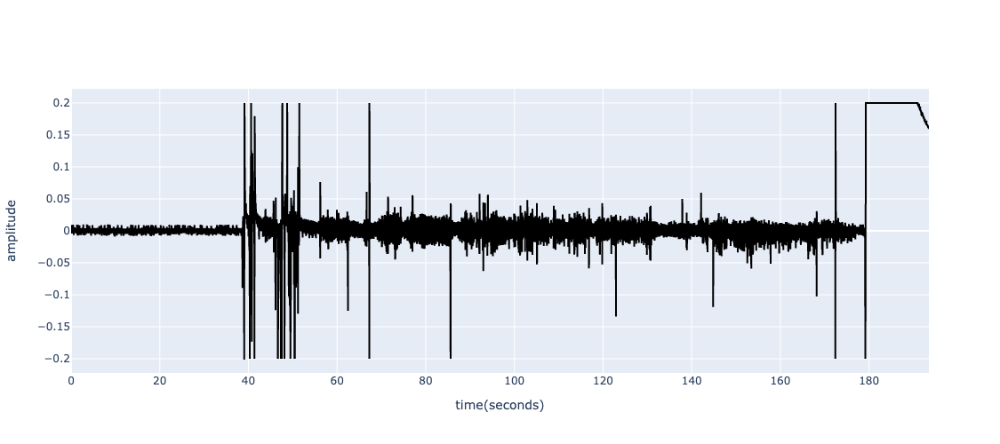

In [59]:

downsample = True #@param

#@markdown After you have filled out all form fields, 
#@markdown run this code cell to load the data. 

filepath = Path(filepath)

# No need to edit below this line
#################################
data = np.fromfile(Path(filepath), dtype = np.float64)
if number_channels>1:
    data = data.reshape(-1,number_channels)
dur = np.shape(data)[0]/sampling_rate
print('duration of recording was %0.2f seconds' %dur)

fs = 1/sampling_rate
if downsample:
    newfs = 2500 #downsample emg data
    chunksize = int(sampling_rate/newfs)
    if number_channels>1:
        data = data[0::chunksize,:]
    if number_channels==1:
        data = data[0::chunksize]
    fs = np.shape(data)[0]/dur

time = np.linspace(0,dur,np.shape(data)[0])


print('Now be a bit patient while it plots.')
fig = go.Figure()
fig.add_trace(go.Scatter(x = time, y = data,line_color='black',name='channel 1'))
fig.update_layout(xaxis_title="time(seconds)", yaxis_title='amplitude',width=800, height=500)
fig.show()

The plot that was just generated is downsampled (sampling rate decreased relative to the raw data) so that it can be plotted all at once. You should be able to get a general sense of what data you want to focus on at raw resolution. 

List of trial times 
(either manually or using keyboard time stamps... or visually using video tracking??)

define spike threshold

In [ ]:
def make_dataset(trial_samples_list, spike_threshold = 5):
    win = int(1*fs) #1 second window hard-coded for now
    assert np.max(trial_samples_list) < len(data)-win,
    
    data_mat = pd.DataFrame({})
    for i,t in enumerate(trial_samples_list):
        data_mat[str(i)] = data[t:t+win]
    
    # rectify and smooth to get envelope to plot
    filtert = int(0.05*fs)
    data_env = pd.DataFrame({})
    for h in list(data_mat.columns):
        y = data_mat[h] - np.mean(data_mat[h])
        y = np.abs(y)
        y = scipy.ndimage.gaussian_filter(y,filtert)
        df_env[h] = y
    
    # use find peaks to get information about each trial such as number of spikes 
    df_spikes = pd.DataFrame(columns=['number'])
    
    return data_env

In [ ]:
def make_plot(src_data_env,src_data_spikes):
    """
    src is a DataColumn source
    """
        # Blank plot with correct labels
        p = figure(plot_width = 700, plot_height = 700, 
                  title = 'Histogram of Arrival Delays by Carrier',
                  x_axis_label = 'Delay (min)', y_axis_label = 'Proportion')

        # multi line glyph to create overlay of data on each trial
        p.multi_line(source = src_data_env,line_color = 'black',line_alpha=0.75)


        # Styling
        p = style(p)

        return p 

In [ ]:
from bokeh.models.widgets import TextInput
# Create the text input element

text = TextInput(title="Enter a comma-separated list of trial start times")
text.on_change('value',update)




# Update function that accounts for all 3 controls
def update(attr, old, new):
    # get trial times from list in text input (comma separated)
    trial_times_list = text.value.strip(',')
    trial_samples_list = int(trial_times_list * fs)
    
    # Create new ColumnDataSource
    new_src = make_dataset(trial_samples_list, spike_threshold = 5)

    # Update the data on the plot
    src.data.update(new_src.data)

In [ ]:
from bokeh.layouts import column, row, WidgetBox
from bokeh.models import Panel
from bokeh.models.widgets import Tabs
# Put controls in a single element
controls = WidgetBox(carrier_selection, binwidth_select, range_select)
    
# Create a row layout
layout = row(controls, p)